In [59]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [60]:
Age = pd.read_csv('clean_data/AgeGroup.csv')
City = pd.read_csv('clean_data/CountyCity.csv')
Province = pd.read_csv('clean_data/Province.csv')


In [61]:
def RedGreenPalette(data, y, x):
    # Function to create a color palette which maps negative values of y to red and non-negative values to green.
    # Only unique values of y are allowed for a given value of x
    # Duplicate values of x are allowed, but a warning message is displayed as this may lead to unexpected behaviour
    
    
    _func_name = 'RedGreenPalette()'
    palette = {}
    
    #Check the inputs passed are well behaved 
    assert(isinstance(data, pd.DataFrame)), 'Expected data of type pandas.core.frame.DataFrame \
                                                        Type passed {}'.format(type(data))
    
    assert(x in data.columns.values), 'Column {} not found in data'.format(x)
    
    assert(y in data.columns.values), 'Column {} not found in data'.format(y) 
    
    
    
    #Check if x values are unique. If not print a warning message
    if (data[x].values != data[x].unique()).any():
        print('Warning in {}: values passed for x are not unique'.format(_func_name))
    
    
    for x_value in data[x].values:
    
        #y_values is an array. If each value for x has a unique value for y, then this array must always have len() == 1
        y_values = data[data[x] == x_value][y].values

        assert(len(y_values) == 1), 'Expected a unique value for y for a given value of x \
                                but {} values for y were found at x = {}'.format(len(y_values), x_value)
    
        #Check sign and assign the appropriate colour
        if y_values[0] < 0:
            palette[x_value] = 'r'
    
        else:
            palette[x_value] = 'g'
    
    
    return palette




def drop_entries(df, col, to_drop):
    #Function to drop rows from the DataFrame df if they contain a value in the list to_drop under column col
    
    
    #Check the inputs passed are well behaved
    assert(isinstance(df, pd.DataFrame)), 'Expected df of type pandas.core.frame.DataFrame \
                                                        Type passed {}'.format(type(df))
    
    assert(col in df.columns.values), 'Column {} not found in df'.format(col)
    
    
    #Try to drop the rows, if this fails return the original DataFrame
    try: 
        tmp_df = df.drop(index = df[df[col].isin(to_drop)].index)
    
    except:
        
        print('In drop_entries(), failed to drop entries passed in to_drop')
        tmp_df = df
    
    return tmp_df


In [62]:
def replace_string(x):
    if x[-6:] == ' years':
        x = x[:-6]
        
    elif x == '85 years and over':
        x = '>= 85'
        
    else:
        x = x
    
    return x
        
 

def minimum_age(x):
    try:
        x = int(x[:2])
    
    except:
        if x == '>= 85':
            x = 85
        else:
            x = 0
    
    return x



def trim_area(x):
    
    if x[-16:] == ' Gaeltacht Areas':
        x = x[:-16]
    
    else:
        x = x
    
    return x
    
# Re-Label some of the Age Groups in('3-4 years' -> '3-4' and '85 years and over' -> '>=85')
Age['Age Group'] = Age['Age Group'].apply(replace_string)

#Create a column called Minimum age. We'll us this to sort the Age Groups in ascending order
Age['Minimum Age'] = Age['Age Group'].apply(minimum_age)
Age.sort_values(by = ['Minimum Age', 'Area'], inplace = True)

#Remove '  Gaeltacht Areas' from the area names
Age['Area'] = Age['Area'].apply(trim_area)

In [ ]:
#I want to look at how age groups change from one year to another.
#I'll drop these groups since I don't think they're comparable to others
to_drop = ['All ages', '3 - 4', '>= 85']

In [69]:
#Let's split the data by Year
Sample2016 = Age[Age['Year'] == 2016]
Sample2011 = Age[Age['Year'] == 2011]


In [100]:
#The columns which store the numeric values
Numeric_columns = ['Irish Speakers', 'Irish Speakers(%)', 'Non-Irish Speakers', 'Not Stated', 'Population']


# Let's look at the change in stats as groups move from one demographic to another 
# e.g. compare '5-9' from 2011 with '10-14' from 2016, 
# since this group would have moved into that demographic over this time period


# I'll remove any stats in the '3-4', '5-9' and '>=85' from the 2016 data
AgeDemographics2016 = drop_entries(Sample2016, 'Minimum Age', [85, 0, 3, 5]).sort_values(by = 'Minimum Age')
AgeDemographics2016.reset_index(inplace = True, drop = True)
 
    
    
# I'll remove any stats in the '3-4', '80-85' and '>=85' from the 2011 data
AgeDemographics2011 = drop_entries(Sample2011, 'Minimum Age', [85, 0, 3, 80]).sort_values(by = 'Minimum Age')
AgeDemographics2011.reset_index(inplace = True, drop = True)



#Check that the Areas are sorted consistently across the DataFrames
(AgeDemographics2016['Area'] == AgeDemographics2011['Area']).all()



In [122]:
#Subtract the dataframes and assign the area and age group
ChangewithDemographic = AgeDemographics2016[Numeric_columns] - AgeDemographics2011[Numeric_columns]
ChangewithDemographic[['Age Group', 'Area']] = AgeDemographics2016[['Age Group', 'Area']]
ChangewithDemographic.head()

,Irish Speakers,Irish Speakers(%),Non-Irish Speakers,Not Stated,Population,Age Group,Area
0,250,5.1,-355,-7,-112,10 - 14,All
1,7,1.3,-5,2,4,10 - 14,Cork
2,20,4.3,-80,-1,-61,10 - 14,Donegal
3,9,8.6,-104,-6,-101,10 - 14,Galway City
4,112,5.7,-122,-21,-31,10 - 14,Galway County


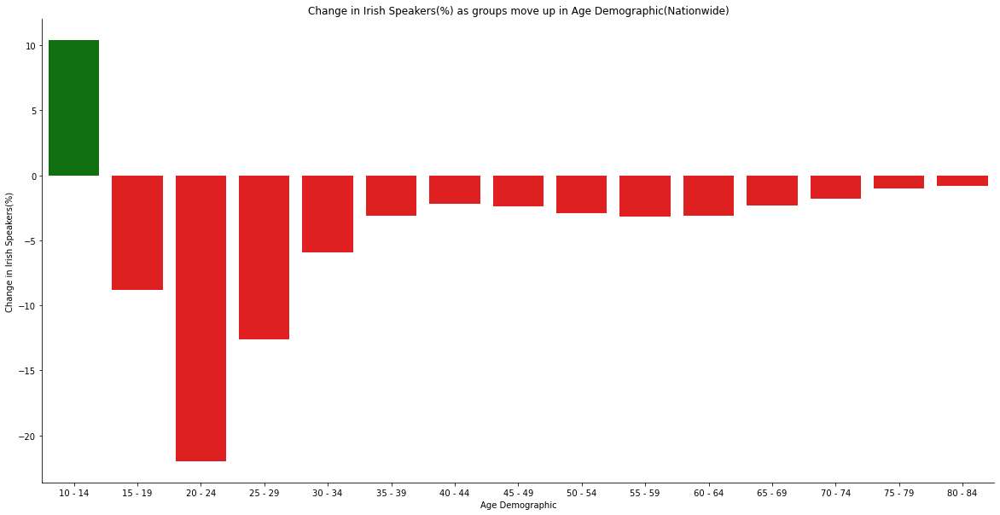

In [121]:
# Let's plot the change in Irish Speakers(%) as people move from one Age Demographic to another
# across the country

x_data = 'Age Group'
y_data = 'Irish Speakers(%)'
area = 'State'

fig, ax = plt.subplots(1, figsize=(20,10))


ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


data =  ChangewithDemographic[ChangewithDemographic['Area'] == area]

palette = RedGreenPalette(data = data, y = y_data, x = x_data)


sns.barplot(data = data, y = y_data, x = x_data, ax = ax, 
           palette = palette)


ax.set_ylabel('Change in ' + y_data)
ax.set_xlabel('Age Demographic')
ax.set_title('Change in '+ y_data + ' as groups move up in Age Demographic(Nationwide)')


plt.show()

In [132]:
#Now let's look a some geographically data using GeoPandas
import geopandas as gpd
CityGeo = gpd.read_file('Irish_counties.shp')
CityGeo.rename({'COUNTYNAME': 'County/City'}, inplace = True, axis = 1)

# This DataFrame contains the geomatries for Isish counties, cities and provinces
CityGeo.head()

,County/City,geometry
0,Carlow,"POLYGON ((286831.002 185881.970, 287438.116 18..."
1,Cavan,"POLYGON ((204973.642 339498.716, 205332.927 33..."
2,Clare,"MULTIPOLYGON (((127054.524 212523.834, 127284...."
3,Connacht,"MULTIPOLYGON (((133100.457 216041.189, 133130...."
4,Cork,"MULTIPOLYGON (((84848.016 49312.025, 84828.004..."


In [137]:
#Let's write a list of any counties in the City DataFrame that aren't in CityGeo DataFrame
missing_counties = []
for county in City['County/City'].unique():
    
    if county not in CityGeo['County/City'].unique():
        missing_counties.append(county)

missing_counties

['Limerick City and County', 'Waterford City and County']

In [138]:
CityGeo['County/City'].unique()

array(['Carlow', 'Cavan', 'Clare', 'Connacht', 'Cork', 'Cork City',
       'Cork County', 'Donegal', 'Dublin', 'Dublin City',
       'Dún Laoghaire-Rathdown', 'Fingal', 'Galway', 'Galway City',
       'Galway County', 'Kerry', 'Kildare', 'Kilkenny', 'Laois',
       'Leinster', 'Leitrim', 'Limerick', 'Limerick City',
       'Limerick County', 'Longford', 'Louth', 'Mayo', 'Meath',
       'Monaghan', 'Munster', 'North Tipperary', 'Offaly', 'Roscommon',
       'Sligo', 'South Dublin', 'South Tipperary', 'State', 'Tipperary',
       'Ulster', 'Waterford', 'Waterford City', 'Waterford County',
       'Westmeath', 'Wexford', 'Wicklow'], dtype=object)

In [139]:
# We need to rename these areas in City so the names between CityGeo and City are consistent
rename_dict = {'Limerick City and County': 'Limerick',
               'Waterford City and County': 'Waterford'}

for key in rename_dict:
 City['County/City'].where(City['County/City']!= key, rename_dict[key], inplace = True)


# Check again if any counties are missing
missing_counties = []
for county in City['County/City'].unique():
    
    if county not in CityGeo['County/City'].unique():
        missing_counties.append(county)

missing_counties

[]

In [158]:
# Now we want to drop any rows from CityGeo whose 'County/City' isn't in 
# City['County/City'] since we won't need those geometries
CityGeo = CityGeo[CityGeo['County/City'].isin(City['County/City'].values)]


# Now use the merge() method to append CityGeo['geometry'] to the right of City. 
# Then set the City DataFrame as a GeoDataFrame
City = City.merge(CityGeo, on='County/City', how='inner')
City = gpd.GeoDataFrame(City, crs = CityGeo.crs, geometry = 'geometry')

City.head()

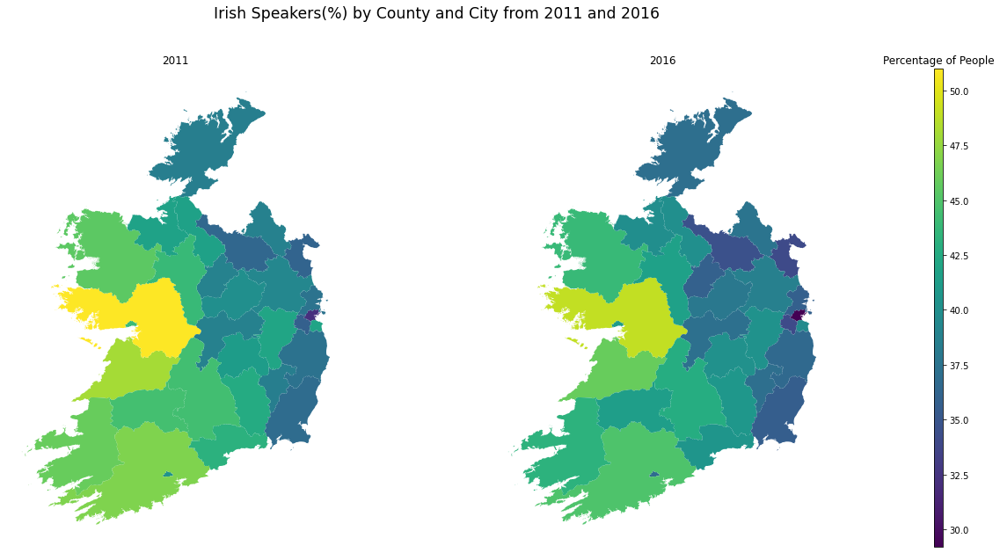

In [175]:
# Now we can finally plot the data


# I use these to create the colormap for the plots
from matplotlib.colors import Normalize
from matplotlib import cm 


#Allocate the Data to be plotted
zdata = 'Irish Speakers(%)'
colors = 'viridis'


Data2011 = City[(City['Year'] == 2011) & (City['Sex'] == 'Both sexes') & (City['County/City'] != 'State')]
Data2016 = City[(City['Year'] == 2016) & (City['Sex'] == 'Both sexes') & (City['County/City'] != 'State')]


fig, axes = plt.subplots(1, 3, figsize = (20,10), gridspec_kw={"width_ratios":[49.5, 49.5, 1]})

fig.suptitle(zdata + ' by County and City from 2011 and 2016', fontsize = 'xx-large')

#Create the colormap using the min/max values
vmin = min(Data2011[zdata].min(), Data2016[zdata].min())
vmax = max(Data2011[zdata].max(), Data2016[zdata].max())                                                            
cmap = cm.ScalarMappable(Normalize(vmin, vmax), colors)

#Create the colorbar with the colormap
plt.colorbar(mappable = cmap, cax = axes[2])
axes[2].set_title('Percentage of People')
                                                                                                                               
                                                                
axes[0].set_title('2011')
axes[1].set_title('2016')

axes[0].axis('off')
axes[1].axis('off')                                                                
                                                                
                                                                
Data2011.plot(column = zdata, ax=axes[0], vmin = vmin, vmax=vmax, cmap = colors)                                                         
Data2016.plot(column = zdata, ax=axes[1], vmin = vmin, vmax=vmax, cmap = colors)


plt.show()

In [176]:
# Now let's run an animation of Irish Speakers by Province. I'll interpolate all the missing years with
# linear interpolation

# List of years we'll animate
total_years = list(range(Province['Year'].min(), Province['Year'].max() + 1))

# These are the missing years we'll have to interpolate
years_to_interpolate = [year for year in total_years if year not in Province['Year'].values]


InterpolateData = Province.copy()

# For each Province, create an empty DataFrame with all the missing years.
# Then append this empty DataFrame to InterpolateData. We'll fill the empty values using the
# interpolate() method
for province in InterpolateData['Province'].unique():
    
    df = pd.DataFrame(data = [], columns = InterpolateData.columns)
    df['Year'] = pd.Series(data = years_to_interpolate)
    df['Province'] = province
    InterpolateData = InterpolateData.append(df)

# Make sure to sort by Province and Year so we interploate the data correctly
InterpolateData.sort_values(by = ['Province', 'Year'], inplace = True)
InterpolateData.interpolate(axis = 0, inplace = True)

InterpolateData['Irish Speakers(%)'] = 100*InterpolateData['Irish Speakers'] / InterpolateData['Total Population']

In [185]:
# Plot this data geographically using GeoPandas
CityGeo = gpd.read_file('Irish_counties.shp')
CityGeo.rename({'COUNTYNAME': 'Province'}, axis = 1, inplace = True)


In [190]:
# Check if we're missing any InterpolateData
missing_province = []
for province in InterpolateData['Province'].unique():
    if province not in CityGeo['Province'].unique():
        missing_province.append(province)
        
missing_province    

[]

In [188]:
CityGeo['Province'].unique()

array(['Carlow', 'Cavan', 'Clare', 'Connacht', 'Cork', 'Cork City',
       'Cork County', 'Donegal', 'Dublin', 'Dublin City',
       'Dún Laoghaire-Rathdown', 'Fingal', 'Galway', 'Galway City',
       'Galway County', 'Kerry', 'Kildare', 'Kilkenny', 'Laois',
       'Leinster', 'Leitrim', 'Limerick', 'Limerick City',
       'Limerick County', 'Longford', 'Louth', 'Mayo', 'Meath',
       'Monaghan', 'Munster', 'North Tipperary', 'Offaly', 'Roscommon',
       'Sligo', 'South Dublin', 'South Tipperary', 'State', 'Tipperary',
       'Ulster', 'Waterford', 'Waterford City', 'Waterford County',
       'Westmeath', 'Wexford', 'Wicklow'], dtype=object)

In [189]:
# We need to rename these areas in Province so the names between CityGeo and Province are consistent
tmp_dict = {'Ulster (pt)': 'Ulster'}

for key in tmp_dict:
 InterpolateData['Province'].where(InterpolateData['Province']!= key, tmp_dict[key], inplace = True)



# Check if we're missing any Provinces
missing_province = []
for province in InterpolateData['Province'].unique():
    if province not in CityGeo['Province'].unique():
        missing_province.append(province)
        
missing_province    

['Ulster (pt)']

In [191]:
# Now we want to drop any rows from CityGeo whose 'Province' isn't in 
# InterpolateData['Province'] since we won't need its geometry
CityGeo = CityGeo[CityGeo['Province'].isin(InterpolateData['Province'].values)]



# Now use the merge() method to append CityGeo to right of InterpolateData. 
# Then set the InterpolateData DataFrame as a GeoDataFrame
InterpolateData = InterpolateData.merge(CityGeo, on='Province', how='inner')
InterpolateData = gpd.GeoDataFrame(InterpolateData, crs = CityGeo.crs, geometry = 'geometry')


In [192]:
from matplotlib.animation import FuncAnimation
from matplotlib.colors import Normalize
from matplotlib import cm 
from IPython.display import HTML

PlotData = InterpolateData[InterpolateData['Province']!='State']
zdata = 'Irish Speakers'
colors = 'Greens'

fig, [ax,cax] = plt.subplots(1, 2, figsize = (10,10), gridspec_kw={"width_ratios":[50,1]})

#Insert a footnote and remove the frame from the plot
ax.text(0 , 0, 'Data was sourced from the CSO\nLinear interpolation was used on years no data', fontsize = 'small')
ax.axis('off')


#Create the colormap using the min/max values
vmin = PlotData[zdata].min()
vmax = PlotData[zdata].max()
cmap = cm.ScalarMappable(Normalize(vmin, vmax), colors)

#Create the colorbar with colormap
plt.colorbar(mappable = cmap, cax = cax)
cax.set_title('Number of People')

#We'll pass this function to FuncAnimation to create the animation
def plot_frame(year):
    
    ax.set_title('Number of Irish Speakers(1 second = 1 Decade): {}'.format(year))
    
    PlotData[PlotData['Year']==year].plot(column = zdata, ax=ax, 
                                          vmin = vmin, vmax=vmax, 
                                          cmap = colors)
    plt.close()


# To solve for the interval argument in FuncAnimation
# 1 frame = 1 year => 10 frames = 1 Decade
# => 10frames/sec = 1Decade/sec => 1frame/100ms = 1Decade/sec => interval = 100

anim = FuncAnimation(fig, plot_frame,  
                    frames = range(PlotData['Year'].min(), PlotData['Year'].max()+1),
                    interval = 100)


HTML(anim.to_jshtml())


In [43]:
from matplotlib.animation import FuncAnimation
from matplotlib.colors import Normalize
from matplotlib import cm 
from IPython.display import HTML


zdata = 'Irish Speakers(%)'
colors = 'Greens'

fig, [ax,cax] = plt.subplots(1, 2, figsize = (10,10), gridspec_kw={"width_ratios":[50,1]})

#Insert a footnote and remove the frame from the plot
ax.text(0 , 0, 'Data was sourced from the CSO\nLinear interpolation was used on years no data', fontsize = 'small')
ax.axis('off')


#Create the colormap using the min/max values
vmin = PlotData[zdata].min()
vmax = PlotData[zdata].max()
cmap = cm.ScalarMappable(Normalize(vmin, vmax), colors)

#Create the colorbar with colormap
plt.colorbar(mappable = cmap, cax = cax)
cax.set_title('Percentage of People')

#We'll pass this function to FuncAnimation to create the animation
def plot_frame(year):
    
    ax.set_title('Percentage of Irish Speakers(1 second = 1 Decade): {}'.format(year))
    
    PlotData[PlotData['Year']==year].plot(column = zdata, ax=ax, 
                                          vmin = vmin, vmax=vmax, 
                                          cmap = colors)
    plt.close()


# To solve for the interval argument in FuncAnimation
# 1 frame = 1 year => 10 frames = 1 Decade
# => 10frames/sec = 1Decade/sec => 1frame/100ms = 1Decade/sec => interval = 100

anim = FuncAnimation(fig, plot_frame,  
                    frames = range(PlotData['Year'].min(), PlotData['Year'].max()+1),
                    interval = 100)


HTML(anim.to_jshtml())


MovieWriter ffmpeg unavailable; using Pillow instead.
